In [24]:
# Import the required libraries
import numpy as np
import matplotlib.pyplot as plt
import cv2
from google.colab.patches import cv2_imshow
from numpy import ones,vstack
from numpy.linalg import lstsq
from scipy.optimize import curve_fit
import os
import math


In [25]:
def edgeDetect(input_image):
     cl = cv2.Canny(input_image, 250, 300)
     return cv2.GaussianBlur(cl, (3,3), 0)

def edgedetection(img):
	clr = cv2.GaussianBlur(img, (3, 3), 0)
	Canny = cv2.Canny(clr, 250, 300)
	return Canny


def cutout_interestregion(img, v):
    mask = np.zeros_like(img)
    if (len(img.shape) > 2):
      channel_count = img.shape[2]
      ignoremask = (255,) * channel_count
    else:
      ignoremask = 255

    cv2.fillPoly(mask, v, ignoremask)

    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


def line_intersect(l1,l2):
      x = (l2[1]-l1[1])/(l1[0]-l2[0])
      if(x <= 800 and x >= 0) and (((l1[0]*x) + l1[1]) >= 0) and ((l1[0]*x) + l1[1] <= 600):
        return [x,(l1[0]*x) + l1[1]]


In [26]:
def average(dictionary):
    xcors1 = 0
    ycors1 = 0
    xcors2 = 0
    ycors2 = 0
    count = 0
    for data in dictionary:
        xcors1 = xcors1 + data[2][0]
        ycors1 = ycors1 + data[2][1]
        xcors2 = xcors2 + data[2][2]
        ycors2 = ycors2 + data[2][3]
        count = count + 1
    xcors1 = xcors1/count
    ycors1 = ycors1/count
    xcors2 = xcors2/count
    ycors2 = ycors2/count

    return (int(xcors1), int(ycors1), int(xcors2), int(ycors2))


def averageLanes(lines):
    try:
        ycor = []

        for i in lines:
            for x in i:
                ycor.append(x[1])
                ycor.append(x[3])

        minY = min(ycor)
        maxY = 600
        linesDict = {}
        finalLines = {}
        lineCount = {}
        for count, i in enumerate(lines):
            for x in i:

                xcors = (x[0], x[2])
                ycors = (x[1], x[3])

                A = vstack([xcors,ones(len(xcors))]).T
                m, b = lstsq(A, ycors)[0]

                x1 = (minY-b) / m
                x2 = (maxY-b) / m

                linesDict[count] = [m,b,[int(x1), minY, int(x2), maxY]]




        status = False
        for i in linesDict:
            finalLinesCopy = finalLines.copy()

            m = linesDict[i][0]
            b = linesDict[i][1]

            line = linesDict[i][2]

            if len(finalLines) == 0:
                finalLines[m] = [[m,b,line]]
            else:
                status = False

                for x in finalLinesCopy:
                    if not status:
                        if abs(x*1.2) > abs(m) > abs(x*0.8):
                            if abs(finalLinesCopy[x][0][1]*1.2) > abs(b) > abs(finalLinesCopy[x][0][1]*0.8):
                                finalLines[x].append([m,b,line])
                                status = True
                                break

                        else:
                            finalLines[m] = [[m,b,line]]


        for i in finalLines:
            lineCount[i] = len(finalLines[i])

        extremes = sorted(lineCount.items(), key=lambda item: item[1])[::-1][:2]
        lane1 = extremes[0][0]
        lane2 = extremes[1][0]

        l1x1, l1y1, l1x2, l1y2 = average(finalLines[lane1])
        l2x1, l2y1, l2x2, l2y2 = average(finalLines[lane2])

        allxcors = [[l1x1, l1x2], [l2x1, l2x2]]
        allycors = [[l1y1, l1y2], [l2y1, l2y2]]

        return allxcors, allycors




    except Exception as e:
        pass




def getPoints(lines):
    xcors = []
    ycors = []
    for i in lines:
        xcors.append(i[0][0])
        ycors.append(i[0][1])
        xcors.append(i[0][2])
        ycors.append(i[0][3])
    return xcors, ycors


def quad_reg(xcors, ycors):
    def func(x, a, b, c):
        return (a*(x**2)) + (b*x) + c
    time = np.array(xcors)
    avg = np.array(ycors)
    initialGuess = [5, 5, -.01]
    guessedFactors = [func(x, *initialGuess) for x in time]
    popt, pcov = curve_fit(func, time, avg, initialGuess)
    cont = np.linspace(min(time), max(time), 50)
    fittedData = [func(x, *popt) for x in cont]

    xcors = []
    ycors = []
    for count, i in enumerate(cont):
       xcors.append(i)
       ycors.append(fittedData[count])

    return popt, xcors, ycors


def linearRegression(X, Y):
    mean_x = np.mean(X)
    mean_y = np.mean(Y)
    m = len(X)
    numer = 0
    denom = 0
    for i in range(m):
        numer += (X[i] - mean_x) * (Y[i] - mean_y)
        denom += (X[i] - mean_x) ** 2
    b1 = numer / denom
    b0 = mean_y - (b1 * mean_x)

    max_x = np.max(X) + 5
    min_x = np.min(X) - 5
    x = np.linspace(min_x, max_x, 1000)
    y = b0 + b1 * x

    return b1, b0



In [27]:
def fun(frame):
    vert = np.array([[100,550],[375,350],[450,350],[800,550]], np.int32)
    fin = edgeDetect(frame)
    fin = cutout_interestregion(fin, [vert])

    line = cv2.HoughLinesP(fin, 2, np.pi/180, 20, 7, 7)
    if not(line is None):
        for i in line:
            cv2.line(frame, (i[0][0], i[0][1]) , (i[0][2], i[0][3]), (255,0,0), 10)

    l1dataset = []
    l2dataset = []
    try:
        straightxcors, straightycors = averageLanes(line)
        xcors, ycors = getPoints(line)

        l1dataset.append(straightxcors[0])
        l1dataset.append(straightycors[0])
        l2dataset.append(straightxcors[1])
        l2dataset.append(straightxcors[1])
        allstraightxcors = straightxcors[0] + straightxcors[1]
        allstraightycors = straightycors[0] + straightycors[1]

        l1m ,l1b = linearRegression(l1dataset[0], l1dataset[1])
        l2m ,l2b = linearRegression(l2dataset[0], l2dataset[1])

        allm, allb = linearRegression(allstraightxcors, allstraightycors)
        allxcor1 = int((allm * 350) + allb)
        allxcor2 = int(allb)

        filterl1x = []
        filterl1y = []
        filterl2x = []
        filterl2y = []




        for count, i in enumerate(ycors):
            if (i*l2m + l2b < xcors[count]):
                filterl2x.append(xcors[count])
                filterl2y.append(i)
            else:
                filterl1x.append(xcors[count])
                filterl1y.append(i)

        l1inx1 = int((600 - l1b) / l1m)
        l1inx2 = int((350-l1b) / l1m)

        l2inx1 = int((600-l2b) / l2m)
        l2inx2 = int((350-l2b) / l2m)

        cv2.line(frame, (int(l1inx1),600), ( int(l1inx2),350), (0,0,0), 10)
        cv2.line(frame, (int(l2inx1),600), ( int(l2inx2),350), (0,0,0), 10)
        turning = ""

        results = line_intersect([l1m,l1b], [l2m, l2b])
        if not (results is None):
            if (results[0] > 400):
                with open("write.txt","a") as f:
                    f.write("Turn to your Left\n")
            else:
                with open("write.txt","a") as f:
                    f.write("Turn to your Right\n")
        else:
            with open("write.txt","a") as f:
                    f.write("Go straight\n")
        try:
            equ1, polyx1, polyy1 = quad_reg(filterl2x, filterl2y)

            for i in range(len(polyx1)):
                if i == 0:
                    pass
                else:
                    cv2.line(frame, (int(polyx1[i]), int(polyy1[i])), (int(polyx1[i-1]), int(polyy1[i-1])), (255,255,0), 10)
        except Exception as e:
            print(e)
        try:
            equ2, polyx2, polyy2 = quad_reg(filterl1x, filterl1y)

            for i in range(len(polyx2)):
                if i == 0:
                    pass
                else:
                    cv2.line(frame, (int(polyx2[i]), int(polyy2[i])), (int(polyx2[i-1]), int(polyy2[i-1])), (255,255,0), 10)

        except:
            pass




    except Exception as e:
        pass

    return frame

In [28]:
def driverprg(Test):
  vid_ob = cv2.VideoCapture(Test)
  #frameRate = vid_ob.get(2)
  while(vid_ob.isOpened()):
        _, frame = vid_ob.read()
        frame = cv2.resize(frame,(800,600))
        cv2_imshow(fun(frame))
        if cv2.waitKey(1) & 0xFF == ord('q'):
          break

  vid_ob.release()
  cv2.destroyAllWindows()


<ipython-input-26-6a5b102823a9>:42: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  m, b = lstsq(A, ycors)[0]


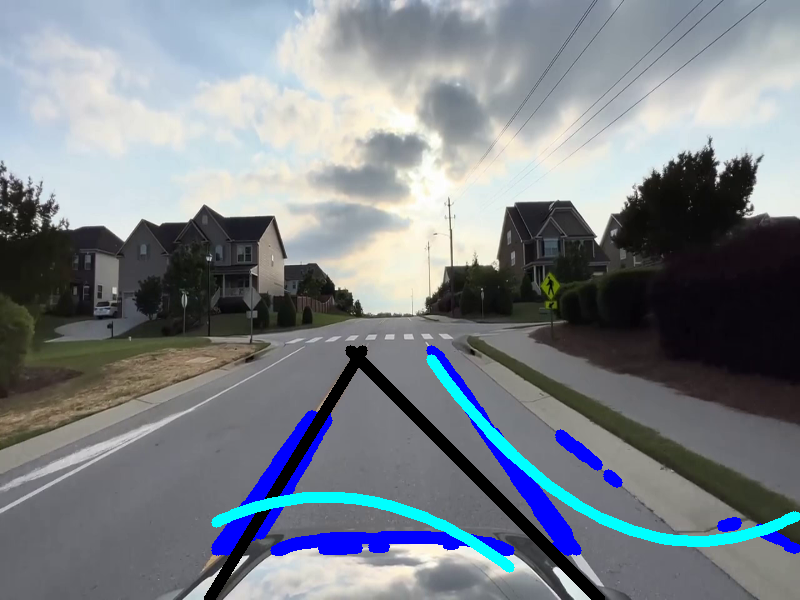

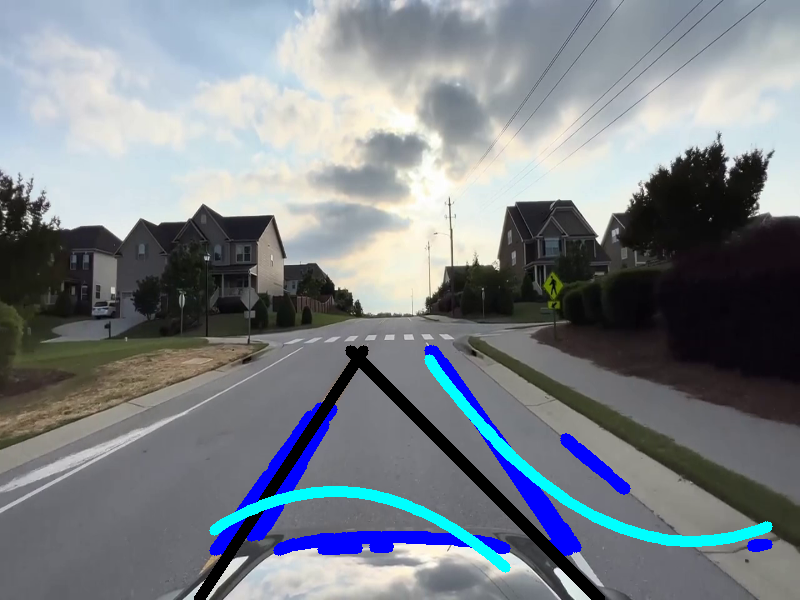

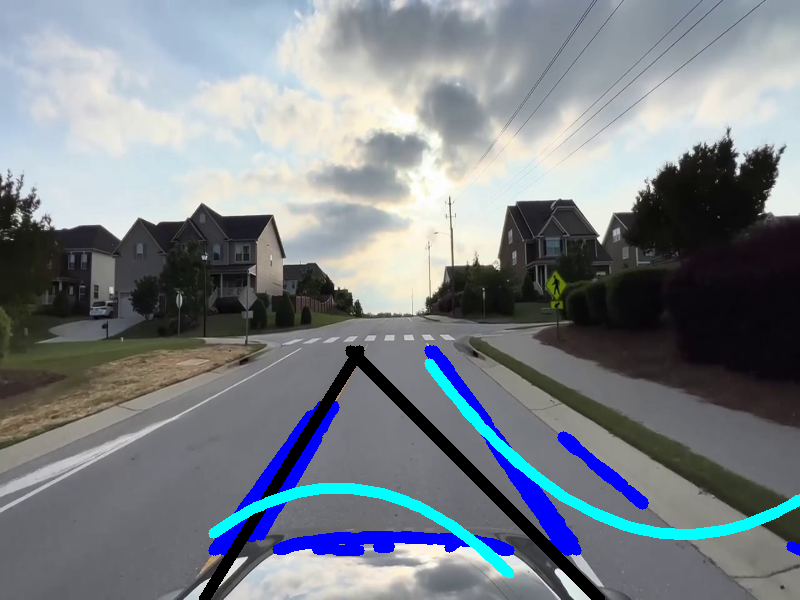

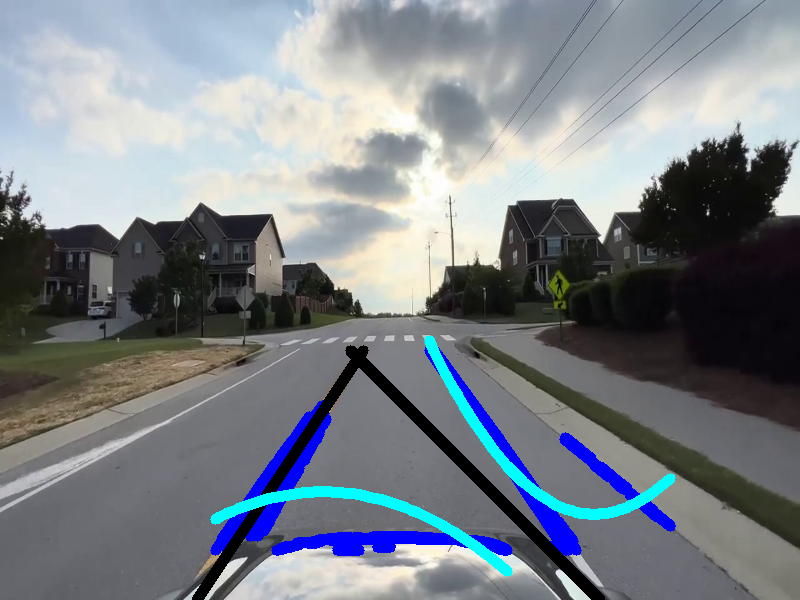

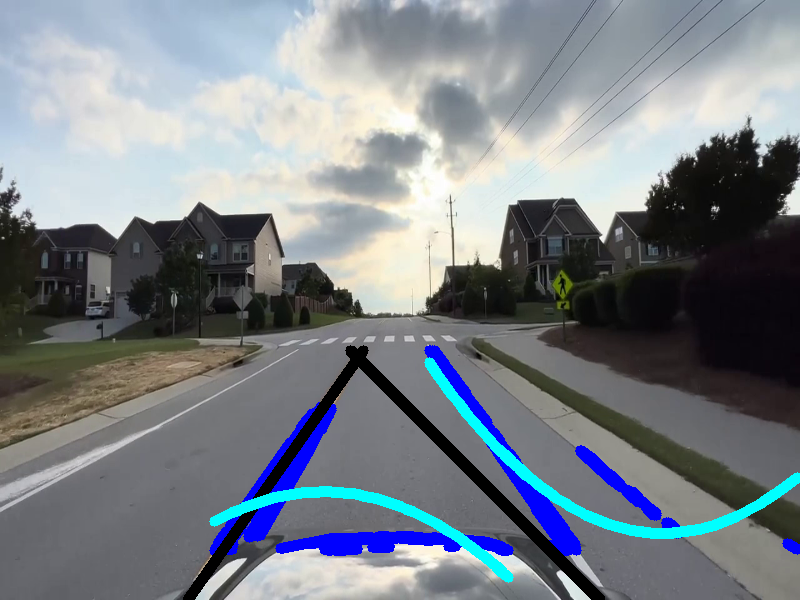

...

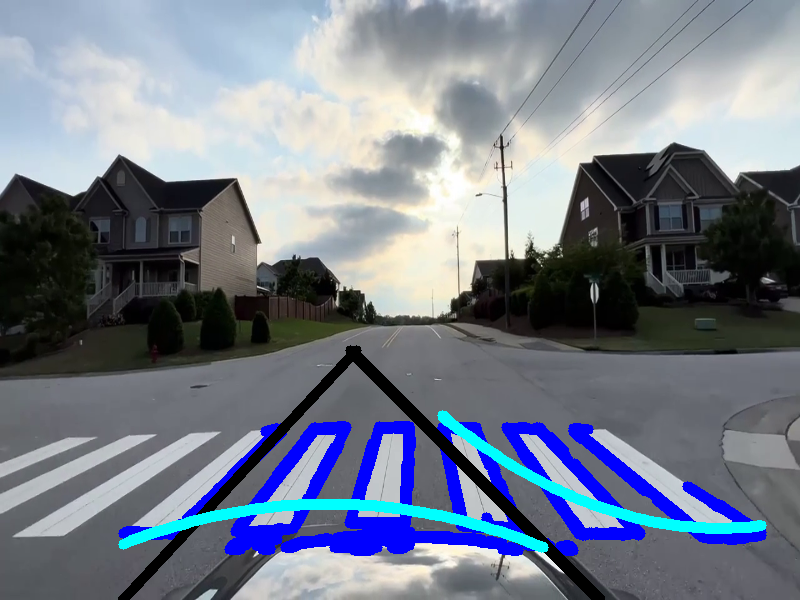

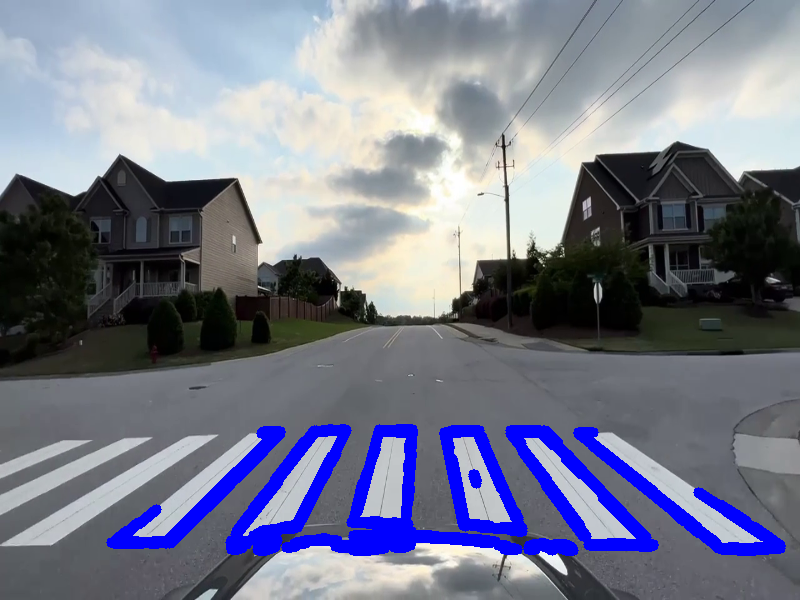

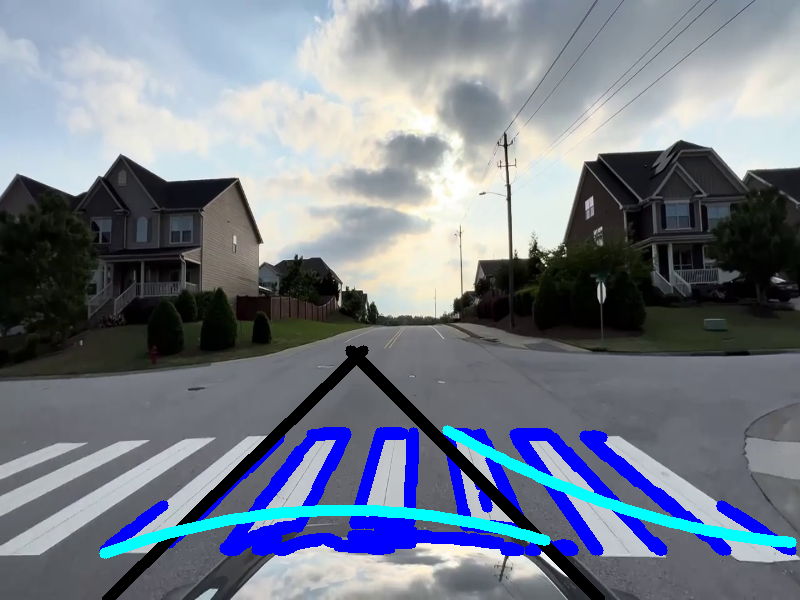

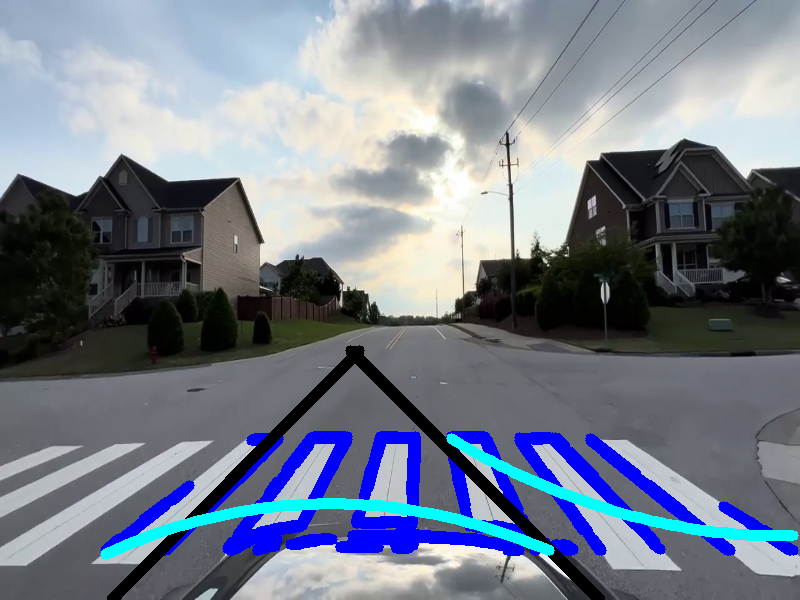

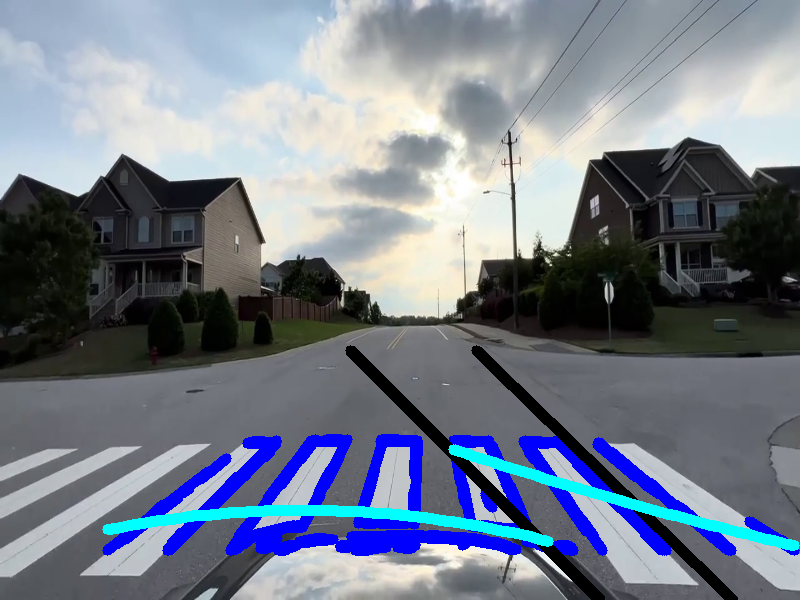

Buffered data was truncated after reaching the output size limit.

In [32]:
driverprg("test.mp4")


In [35]:
f = open('write.text', 'r')
file_contents = f.read()
print (file_contents)

FileNotFoundError: [Errno 2] No such file or directory: 'write.text'

In [33]:
!pip install gTTS

with open('write.txt','r') as file:
    data = file.read()


In [34]:
print(data)

Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Go straight
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Left
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
Turn to your Right
T